# eda003
map上への経路可視化

In [1]:
import os
import pandas as pd
import ipynb_path
import matplotlib.pyplot as plt
from matplotlib_venn import venn2, venn2_circles
import seaborn as sns
import plotly
import plotly.express as px
%matplotlib inline
pd.set_option('display.max_rows', 200)

In [2]:
def get_nb_name():
    nb_path = ipynb_path.get()
    nb_name = nb_path.rsplit('/',1)[1].replace('.ipynb','')
    return nb_name

In [3]:
def visualize_trafic(df, center, zoom=9):
    fig = px.scatter_mapbox(df,
                            
                            # Here, plotly gets, (x,y) coordinates
                            lat="latDeg",
                            lon="lngDeg",
                            
                            #Here, plotly detects color of series
                            color="phoneName",
                            labels="phoneName",
                            
                            zoom=zoom,
                            center=center,
                            height=1000,
                            width=2000)
    fig.update_layout(mapbox_style='stamen-terrain')
    fig.update_layout(margin={"r": 0, "t": 0, "l": 0, "b": 0})
    fig.update_layout(title_text="GPS trafic")
    fig.show()

In [4]:
def one_collection_viz(df, collection):
    target_df = df[df['collectionName']==collection].copy()
    lat_center = target_df['latDeg'].mean()
    lng_center = target_df['lngDeg'].mean()
    center = {"lat":lat_center, "lon":lng_center}
    
    visualize_trafic(target_df, center)

In [5]:
# directory setting
nb_name = get_nb_name()
INPUT = '../input/google-smartphone-decimeter-challenge'
OUTPUT = '../output/' + nb_name
os.makedirs(OUTPUT, exist_ok=True)

In [6]:
# reading data
base_train = pd.read_csv(INPUT + '/' + 'baseline_locations_train.csv')
base_test = pd.read_csv(INPUT + '/' + 'baseline_locations_test.csv')
sample_sub = pd.read_csv(INPUT + '/' + 'sample_submission.csv')
ground_truth_train = pd.read_csv(INPUT + '/prep/ground_truth_train.csv')

In [7]:
usecols = ['collectionName', 'phoneName', 'millisSinceGpsEpoch', 'latDeg', 'lngDeg']

In [8]:
# trainのbaselineとground_truthを結合
train = base_train[usecols].copy()
ground_truth_train['phoneName'] = ground_truth_train['phoneName'] + '_GT'
train = pd.concat([train, ground_truth_train[usecols]])

In [9]:
collections = train['collectionName'].unique()

2020-06-04-US-MTV-1


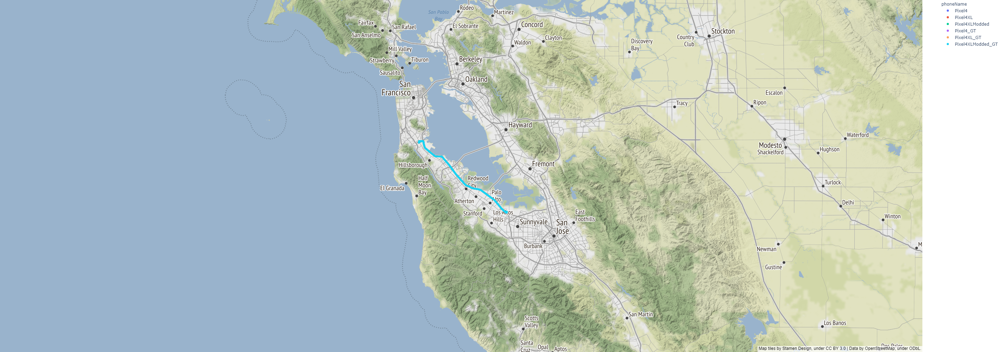

In [11]:
c = collections[6]
print(c)
one_collection_viz(train, c)

In [92]:
# train, testを結合
train_tmp = base_train[usecols].copy()
test_tmp = base_test[usecols].copy()
train_tmp['phoneName'] = 'train'
test_tmp['phoneName'] = 'test'

train_test = pd.concat([train_tmp[usecols], test_tmp[usecols]])

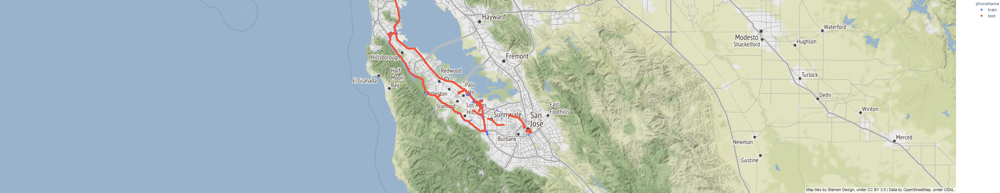

In [94]:
lat_center = train_test['latDeg'].mean()
lng_center = train_test['lngDeg'].mean()
center = {"lat":lat_center, "lon":lng_center}

visualize_trafic(train_test, center)

In [97]:
train[train['lngDeg'] == train['lngDeg'].min()]

,collectionName,phoneName,millisSinceGpsEpoch,latDeg,lngDeg
59220,2020-09-04-US-SF-1,Mi8,1283276368000,37.580437,-122.472214


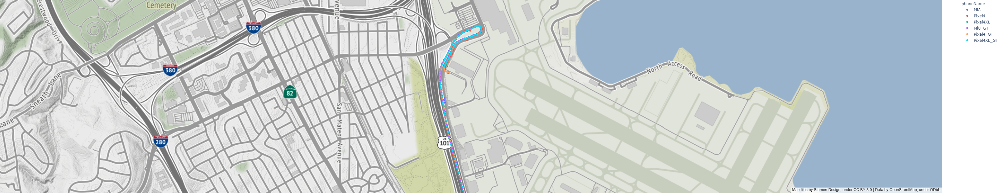

In [98]:
one_collection_viz(train, '2020-09-04-US-SF-1')